In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/infected-tomato-leaf-vein-segmentation/train.csv
/kaggle/input/infected-tomato-leaf-vein-segmentation/test.csv
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf08.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf03.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf22.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf13.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf02.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf12.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf27.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf24.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf10.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/test/leaf16.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/train/leaf04.jpg
/kaggle/input/infected-tomato-leaf-vein-segmentation/train/leaf06.jpg
/kaggle/input/infected-tomato-leaf-vein-segme

In [2]:
train_dir = "/kaggle/input/infected-tomato-leaf-vein-segmentation/train.csv"
test_dir = "/kaggle/input/infected-tomato-leaf-vein-segmentation/test.csv"

In [3]:
df = pd.read_csv(train_dir)

In [4]:
df.tail()

,id,annotation
12,leaf20,62604 0 1 1 873 0 3 1 871 0 5 1 869 0 5 1 870 ...
13,leaf21,53775 0 1 1 873 0 3 1 871 0 5 1 870 0 5 1 870 ...
14,leaf23,51158 0 1 1 873 0 3 1 871 0 5 1 869 0 5 1 869 ...
15,leaf25,43309 0 1 1 873 0 3 1 871 0 5 1 870 0 5 1 869 ...
16,leaf26,24807 0 1 1 873 0 3 1 871 0 5 1 871 0 5 1 870 ...


In [5]:
df.isna()

,id,annotation
0,False,False
1,False,False
2,False,False
3,False,False
4,False,False
5,False,False
6,False,False
7,False,False
8,False,False
9,False,False


In [6]:
df.isnull()

,id,annotation
0,False,False
1,False,False
2,False,False
3,False,False
4,False,False
5,False,False
6,False,False
7,False,False
8,False,False
9,False,False


In [7]:
df.columns

Index(['id', 'annotation'], dtype='object')

In [8]:
type(df.annotation[0])

str

In [9]:
str1 = df.annotation[0]

In [10]:
from io import StringIO

data = StringIO(str1)
df2 = pd.read_csv(data)

In [11]:
df2

""


In [12]:
import numpy as np
HEIGHT = 1400
WIDTH = 875

def rl_decode(enc):
    parts = [int(s) for s in enc.split(' ')]
    dec = list()
    for i in range(0, len(parts), 2):
        cnt = parts[i]
        val = parts[i+1]
        dec += cnt * [val]
    return np.array(dec, dtype=np.uint8).reshape((HEIGHT, WIDTH))

In [13]:
res = []
for i in range(0, 17):
    res.append(rl_decode(df.annotation[i])) 

In [14]:
res

[array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0

In [15]:
import matplotlib.pyplot as plt

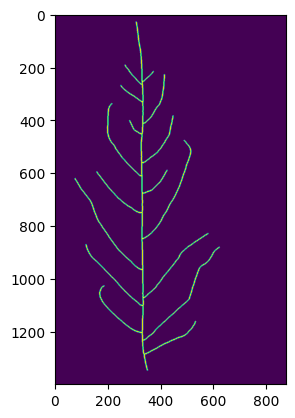

In [16]:
for item in res:
    plt.imshow(item)

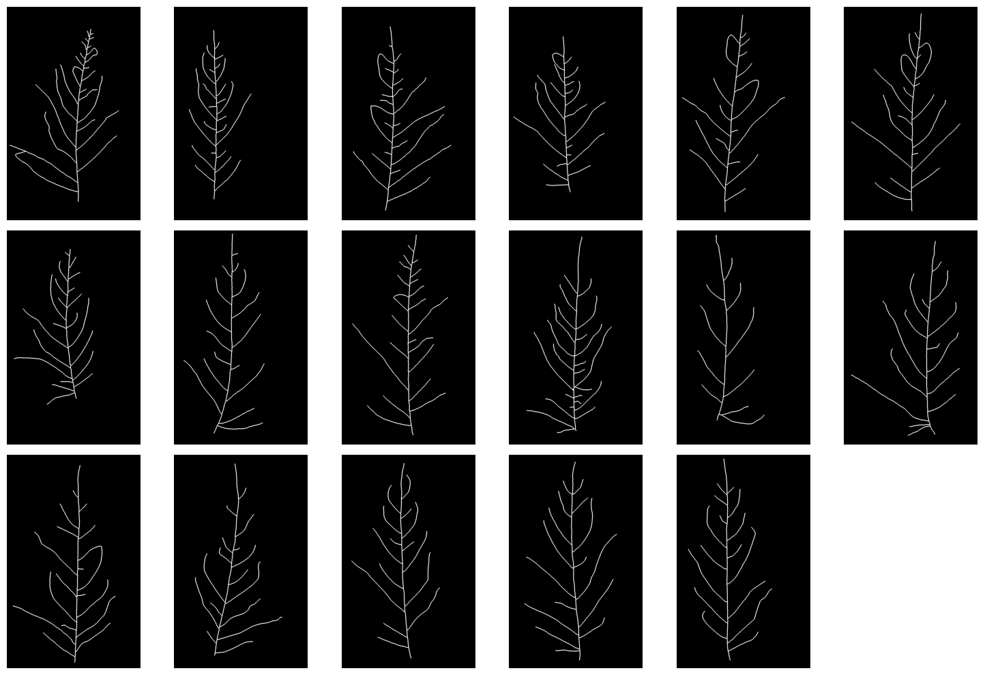

In [17]:
# Set the number of rows and columns for the grid
rows = 3
cols = 6

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(15, 10))

# Flatten the axes array to easily iterate over it
axes = axes.flatten()

# Display each image in its corresponding subplot
for i in range(17):
    axes[i].imshow(res[i], cmap='gray')  # Adjust cmap if images are grayscale
    axes[i].axis('off')  # Turn off the axis labels

# Turn off any extra subplots (in case of a 3x6 grid, there will be 1 empty subplot)
for i in range(17, len(axes)):
    axes[i].axis('off')

# Adjust the layout to prevent overlap
plt.tight_layout()
plt.show()


In [18]:
import cv2
import pandas as pd
import os
from matplotlib import pyplot as plt

In [19]:
image_dir = '/kaggle/input/infected-tomato-leaf-vein-segmentation/train/'

In [20]:
def load_image(img_f):
    img_path = os.path.join(image_dir, img_f)
    img = cv2.imread(img_path)
    if img is not None:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

img_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
img_f = img_files[0]
img = load_image(img_f)

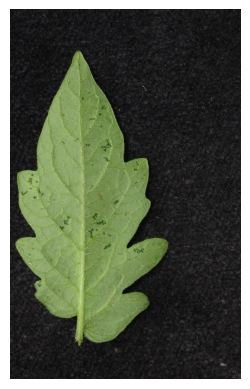

In [21]:
if img is not None:
    plt.imshow(img)
    plt.axis('off')

In [22]:
def alter_image(img):
    flipped_img = cv2.flip(img, 1)
    rotated_img = cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)
    flipped_180_img = cv2.flip(img, -1)

    return flipped_img, rotated_img, flipped_180_img

trainset = []

for img_file in img_files:
    img = load_image(img_file)
    if img is not None:
        flipped_img, rotated_img, flipped_180_img = alter_image(img)
        trainset.append({'original': img,
                         'flipped': flipped_img,
                         'rotated': rotated_img,
                         'flipped_180': flipped_180_img})
        
        

In [23]:
TARGET_SIZE = (256, 256)

def show_image(image, title="Image"):
    plt.imshow(image, cmap='gray' if len(image.shape) == 2 else None)
    plt.title(title)
    plt.axis('off')
    plt.show()

def resize_image(img, target_size=TARGET_SIZE):
    resized_img = cv2.resize(img, target_size)
    show_image(resized_img, title="Resized Image")
    return resized_img

def grayscale_image(img):
    grayscale_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    show_image(grayscale_img, title="Grayscale Image")
    return grayscale_img

In [24]:
def preprocess_image(img, resize=True, to_grayscale=True):
    if resize:
        image = resize_image(img)
    if to_grayscale:
        image = grayscale_image(img)
    
    return image

Preprocessing original image:


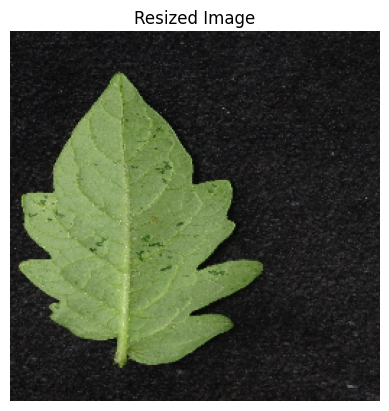

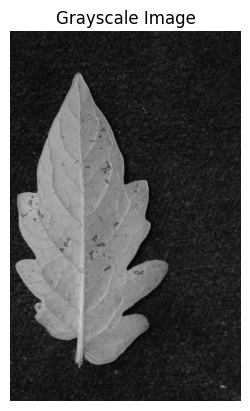

Preprocessing flipped image:


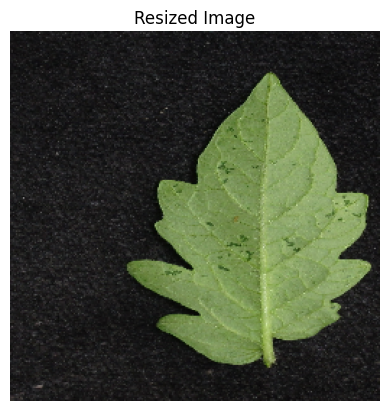

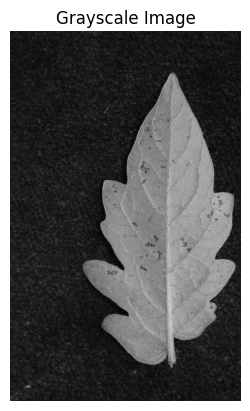

Preprocessing rotated image:


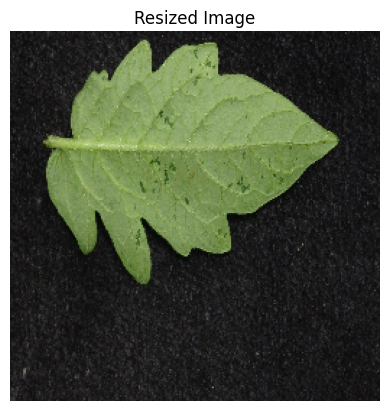

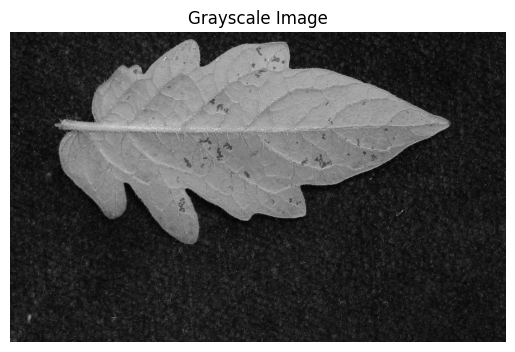

Preprocessing flipped 180 image:


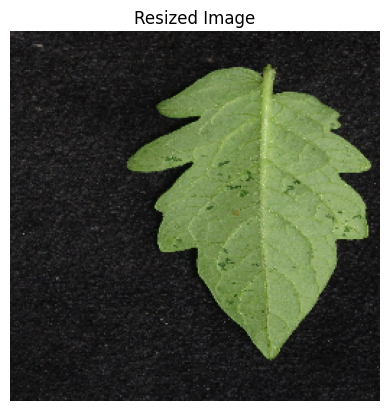

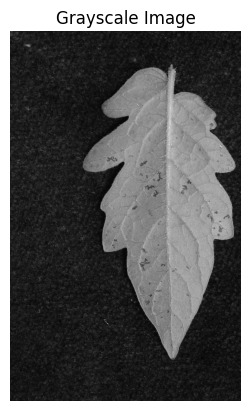

Preprocessing complete for one set of images.
Preprocessing original image:


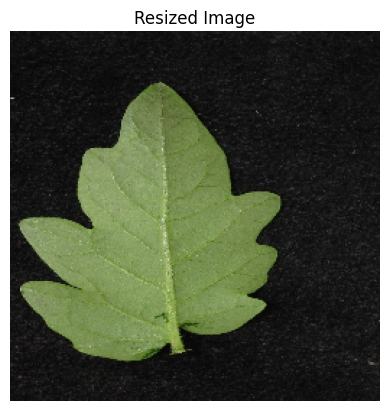

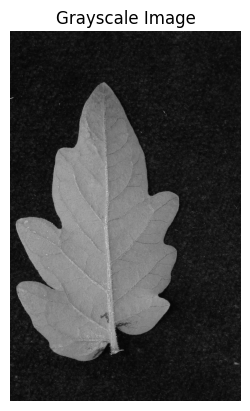

Preprocessing flipped image:


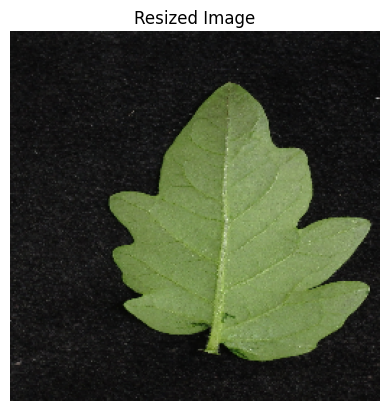

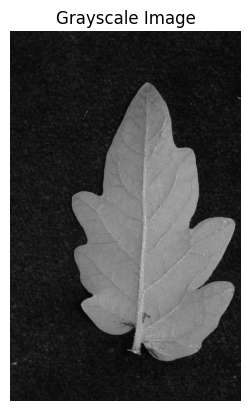

Preprocessing rotated image:


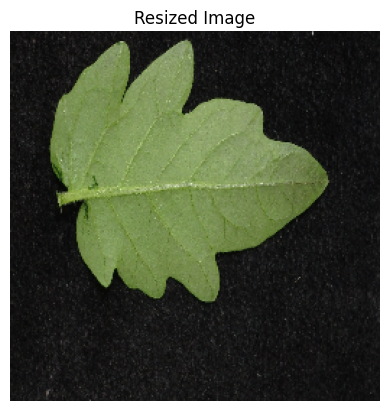

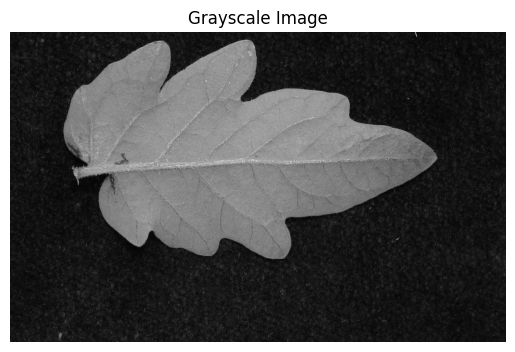

Preprocessing flipped 180 image:


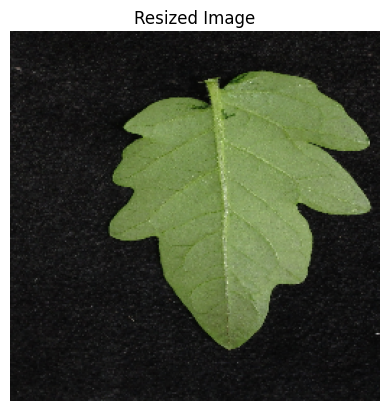

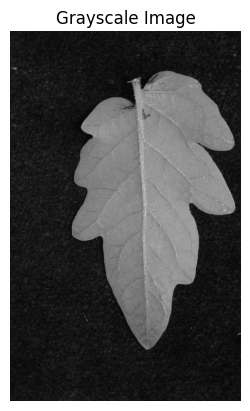

Preprocessing complete for one set of images.
Preprocessing original image:


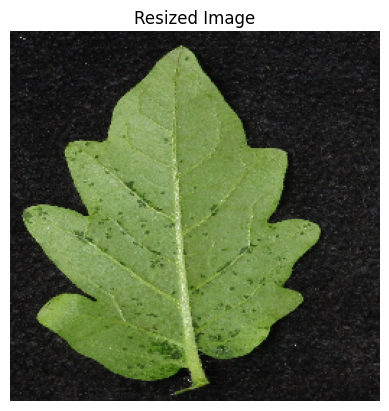

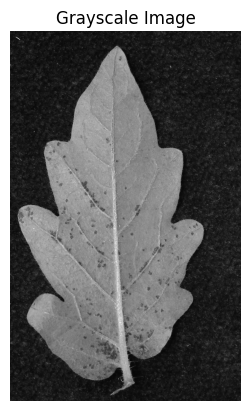

Preprocessing flipped image:


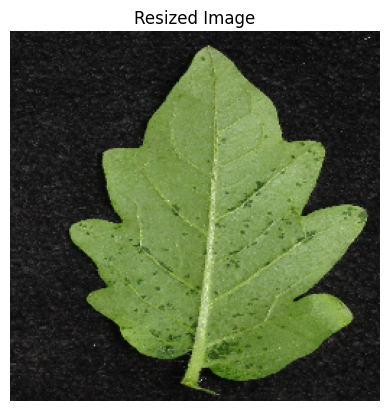

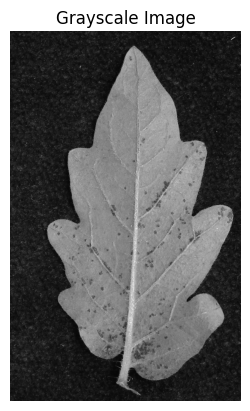

Preprocessing rotated image:


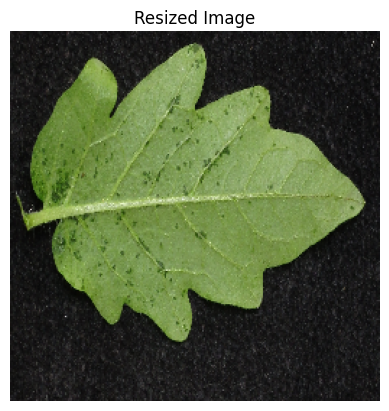

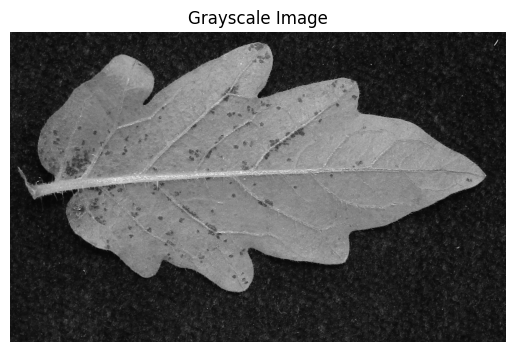

Preprocessing flipped 180 image:


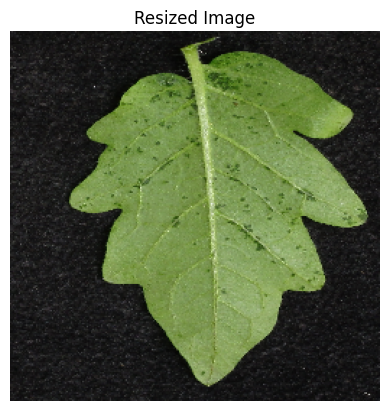

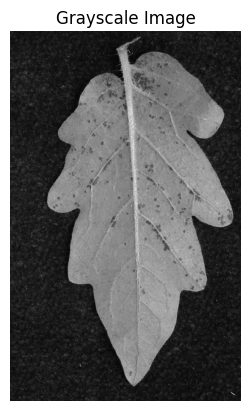

Preprocessing complete for one set of images.
Preprocessing original image:


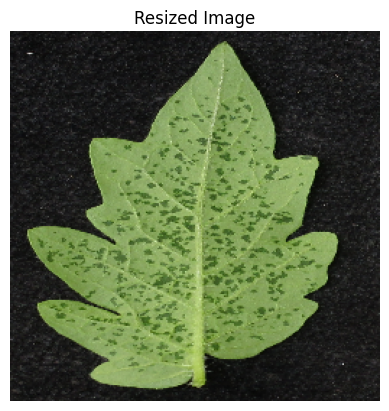

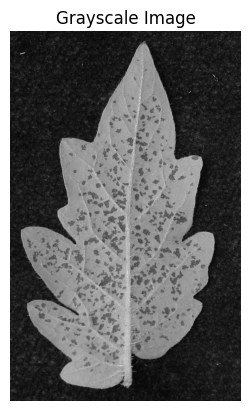

Preprocessing flipped image:


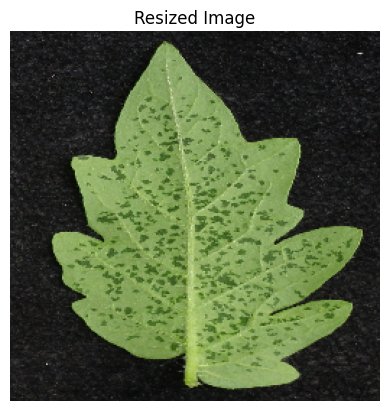

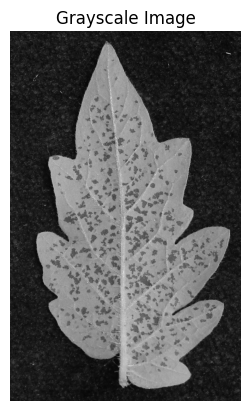

Preprocessing rotated image:


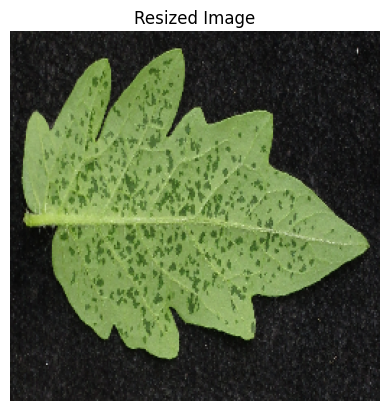

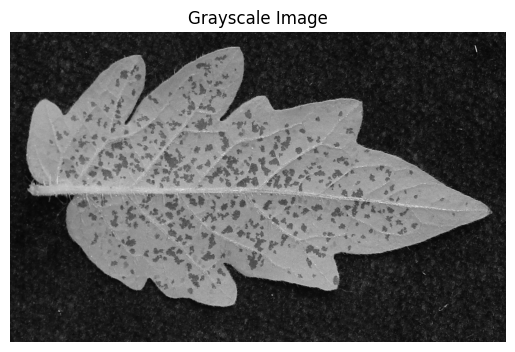

Preprocessing flipped 180 image:


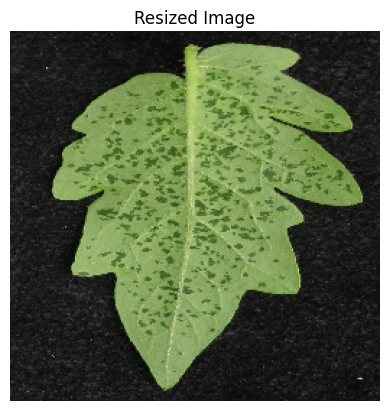

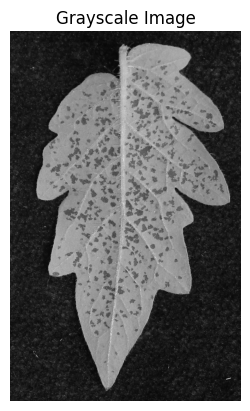

Preprocessing complete for one set of images.
Preprocessing original image:


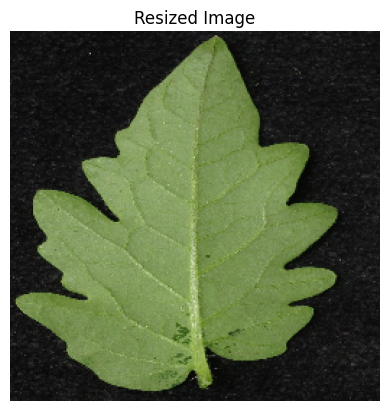

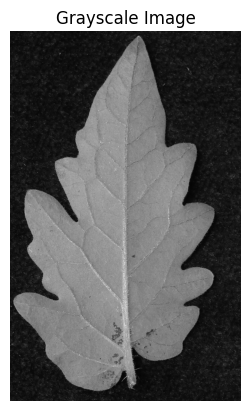

Preprocessing flipped image:


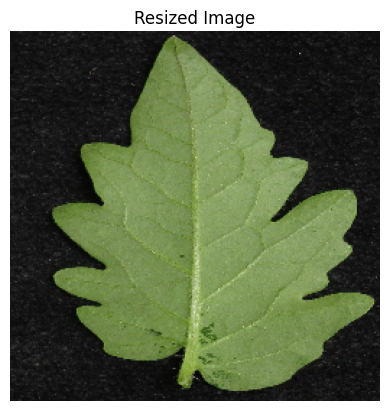

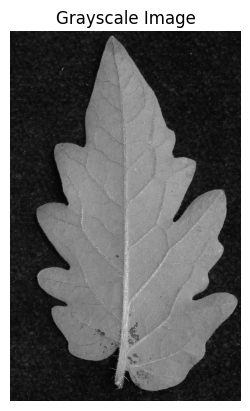

Preprocessing rotated image:


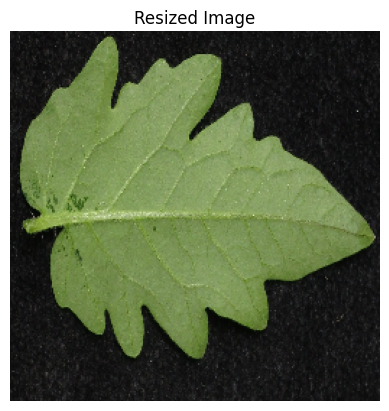

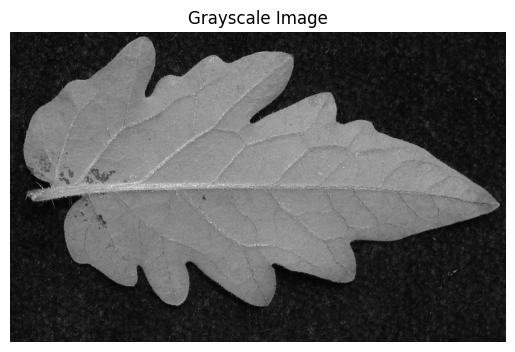

Preprocessing flipped 180 image:


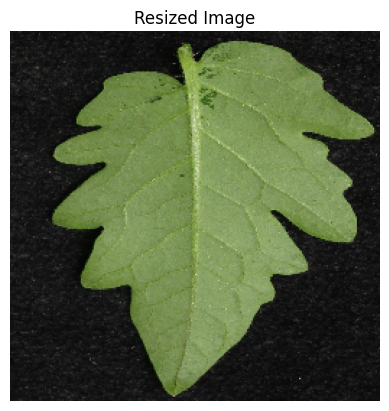

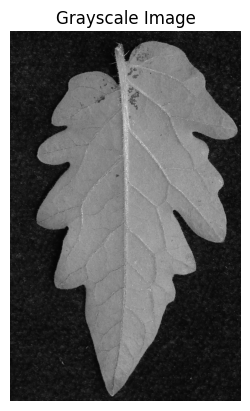

Preprocessing complete for one set of images.
Preprocessing original image:


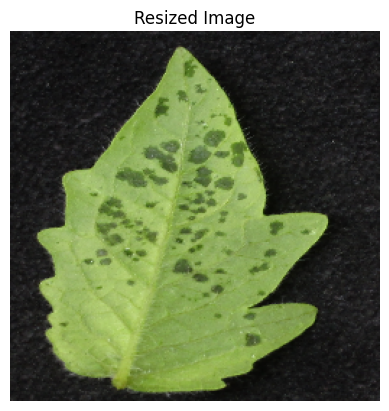

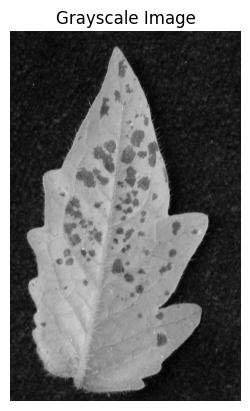

Preprocessing flipped image:


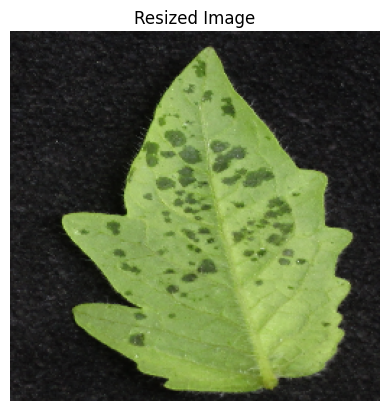

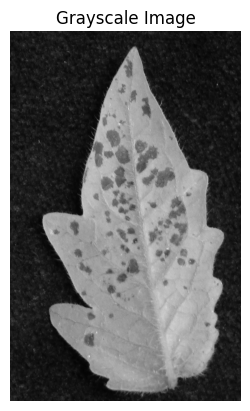

Preprocessing rotated image:


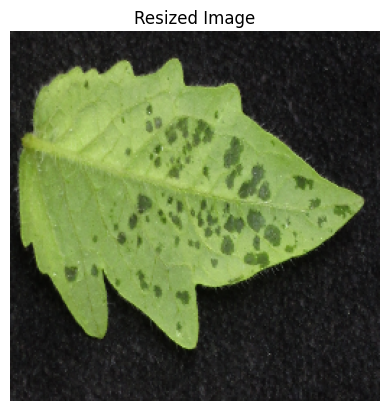

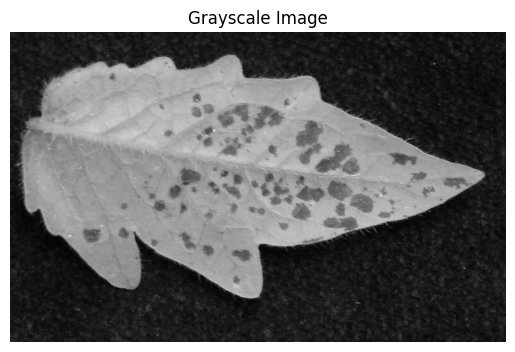

Preprocessing flipped 180 image:


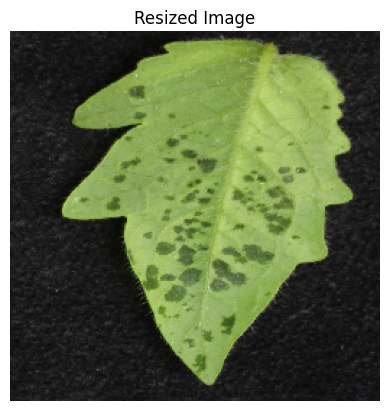

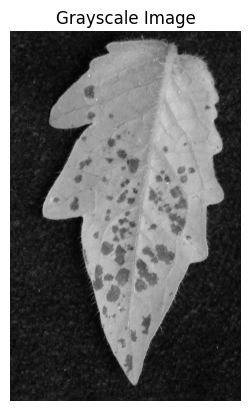

Preprocessing complete for one set of images.
Preprocessing original image:


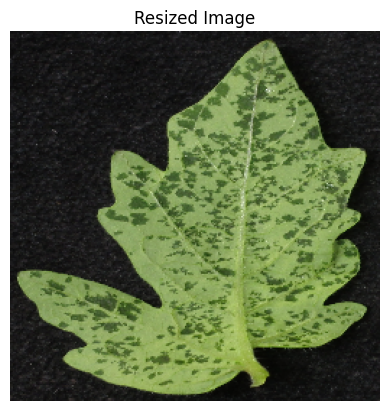

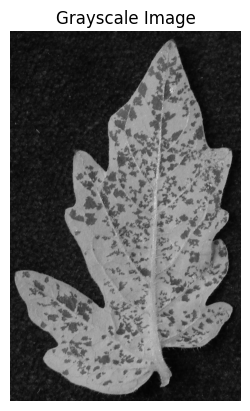

Preprocessing flipped image:


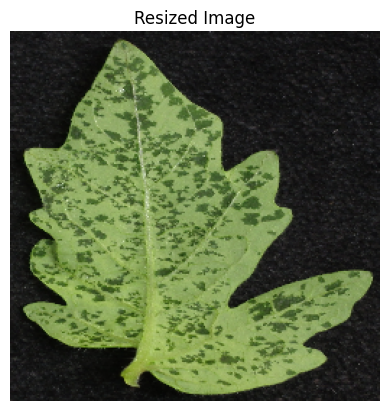

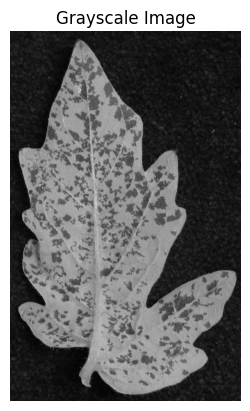

Preprocessing rotated image:


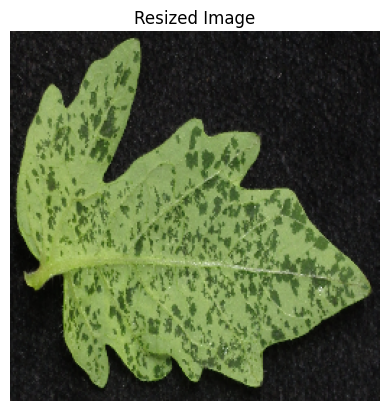

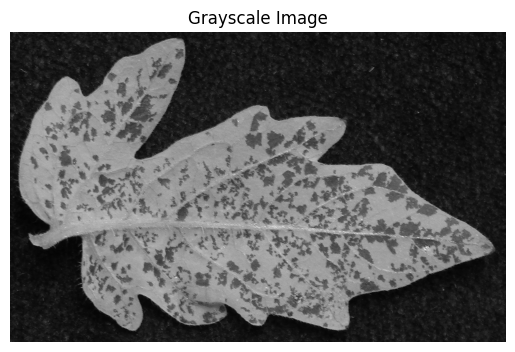

Preprocessing flipped 180 image:


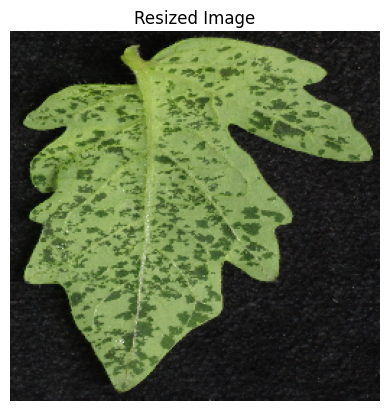

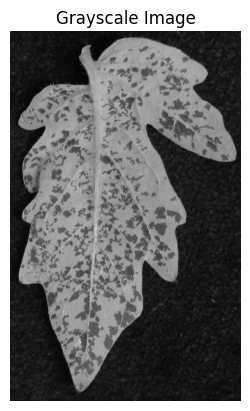

Preprocessing complete for one set of images.
Preprocessing original image:


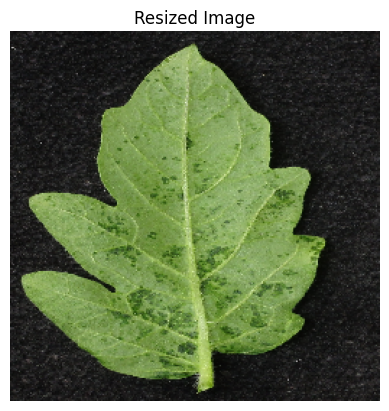

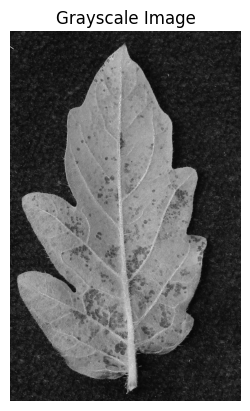

Preprocessing flipped image:


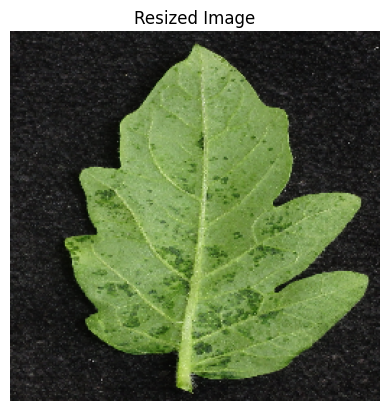

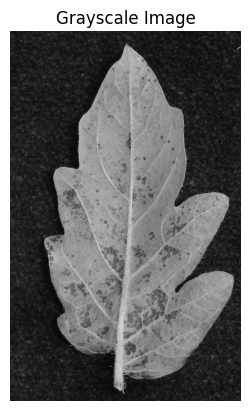

Preprocessing rotated image:


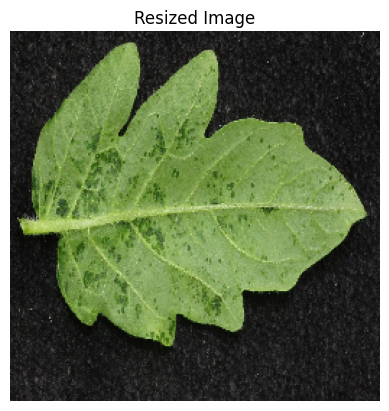

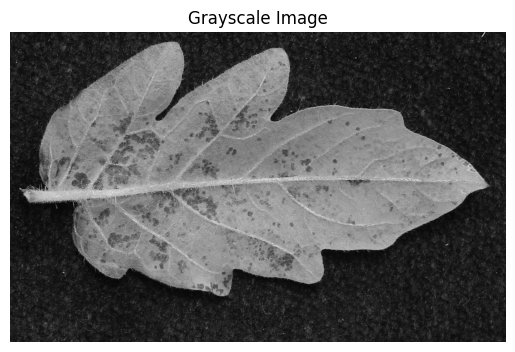

Preprocessing flipped 180 image:


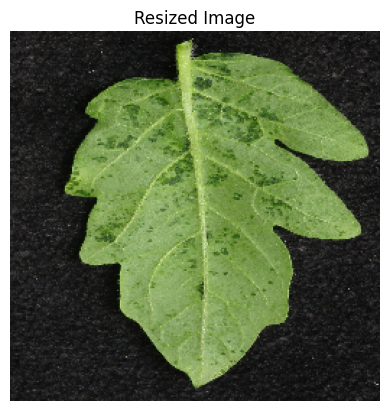

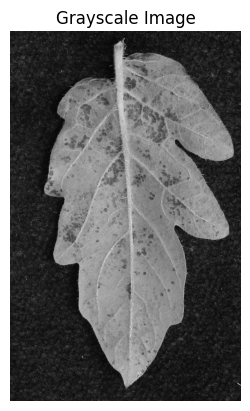

Preprocessing complete for one set of images.
Preprocessing original image:


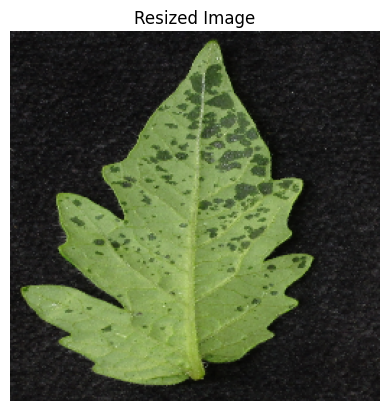

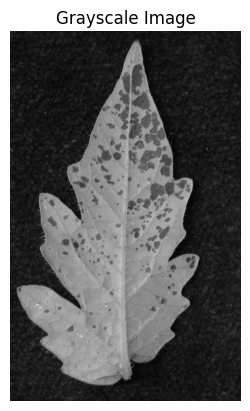

Preprocessing flipped image:


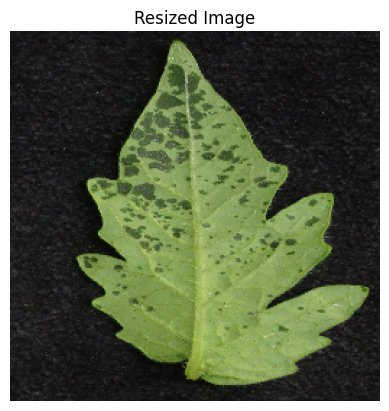

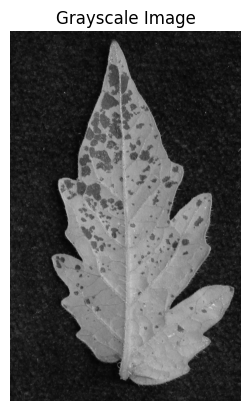

Preprocessing rotated image:


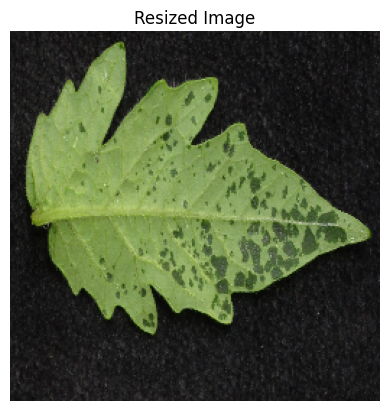

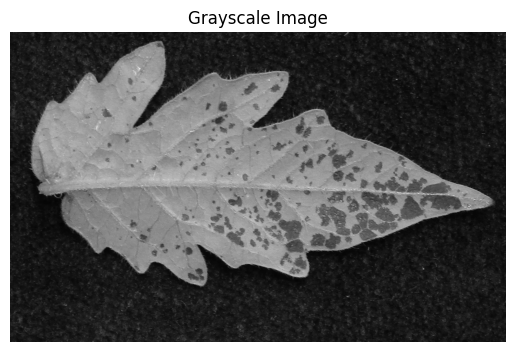

Preprocessing flipped 180 image:


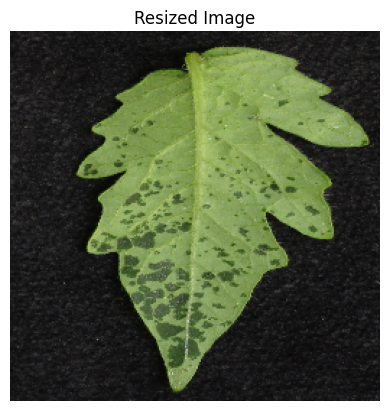

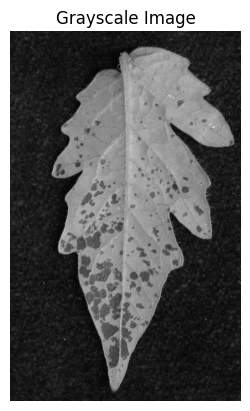

Preprocessing complete for one set of images.
Preprocessing original image:


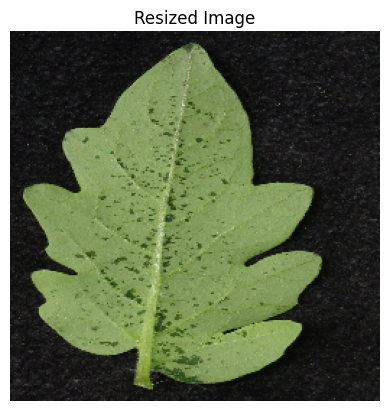

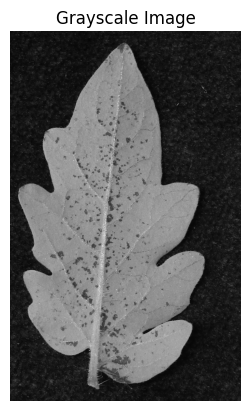

Preprocessing flipped image:


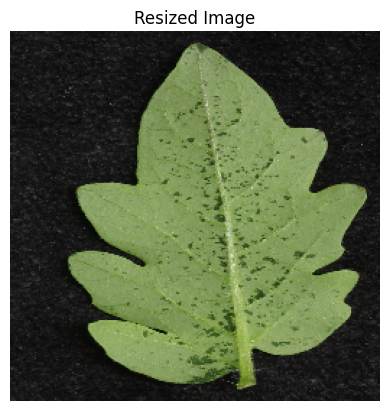

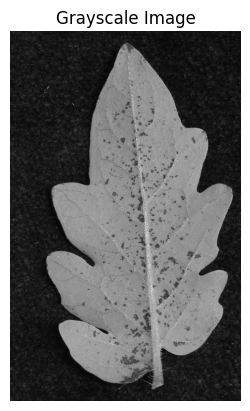

Preprocessing rotated image:


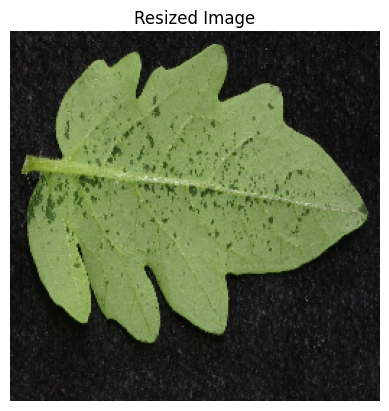

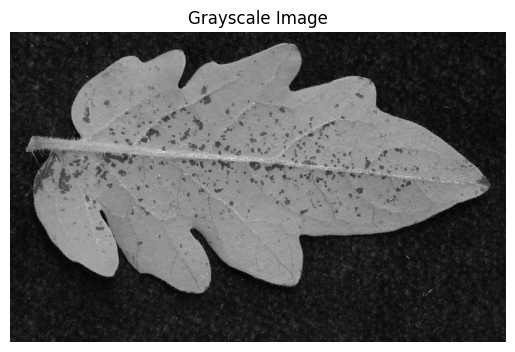

Preprocessing flipped 180 image:


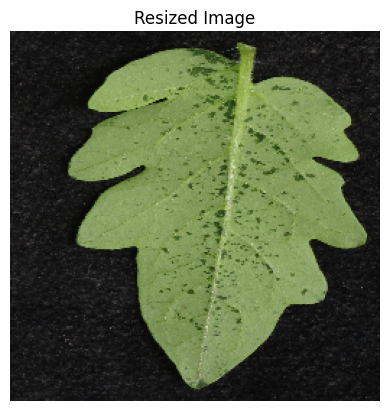

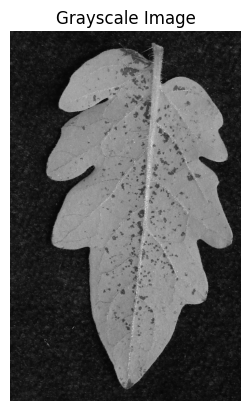

Preprocessing complete for one set of images.
Preprocessing original image:


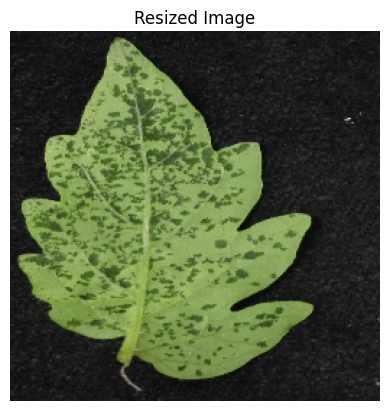

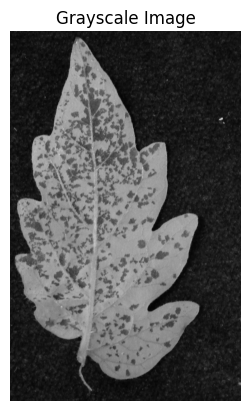

Preprocessing flipped image:


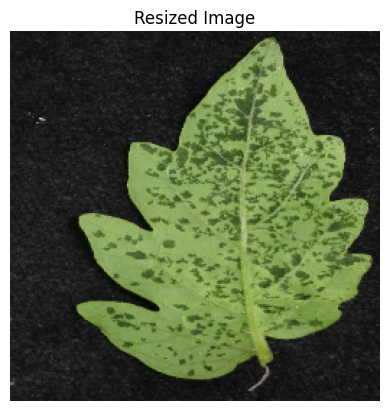

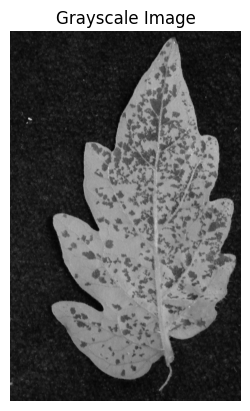

Preprocessing rotated image:


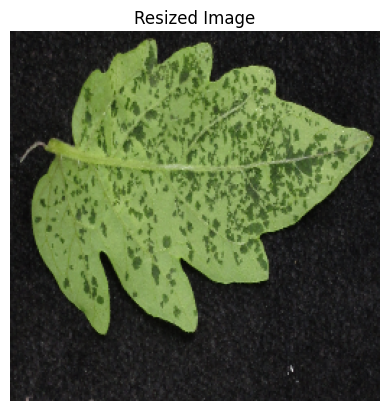

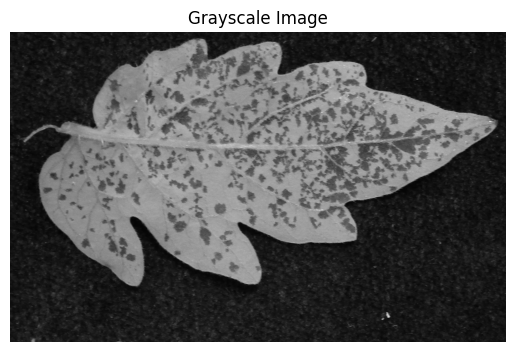

Preprocessing flipped 180 image:


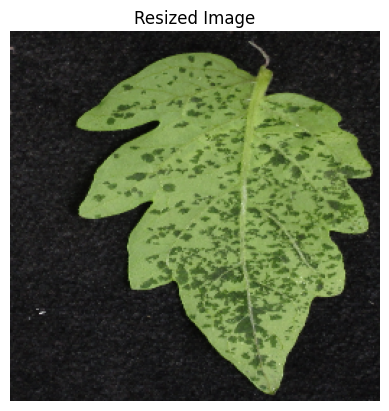

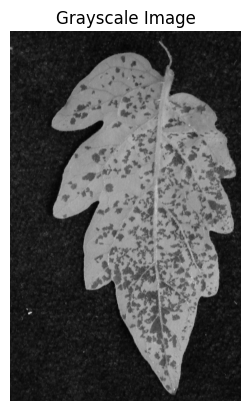

Preprocessing complete for one set of images.
Preprocessing original image:


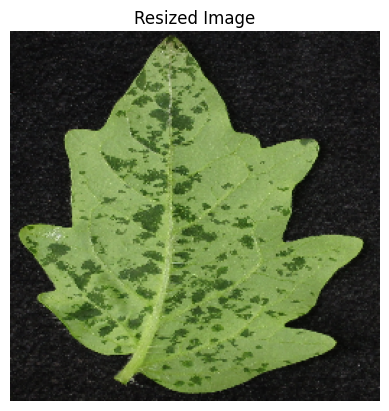

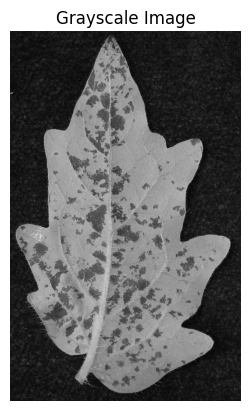

Preprocessing flipped image:


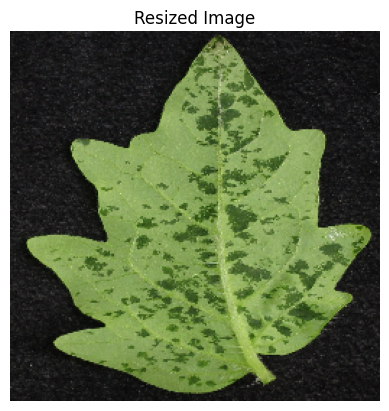

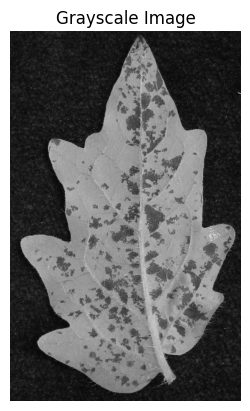

Preprocessing rotated image:


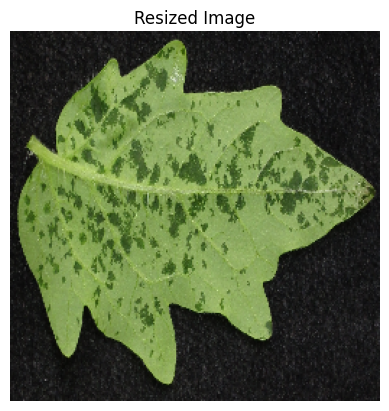

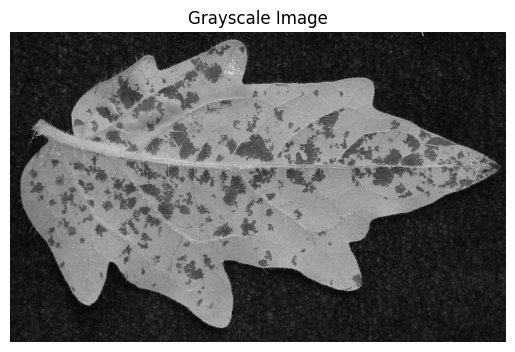

Preprocessing flipped 180 image:


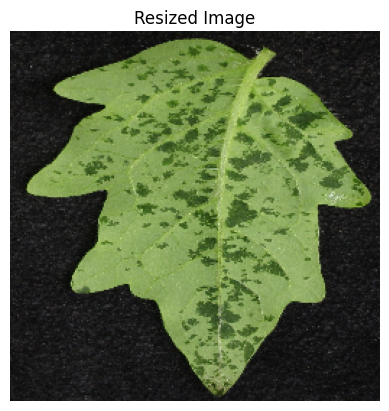

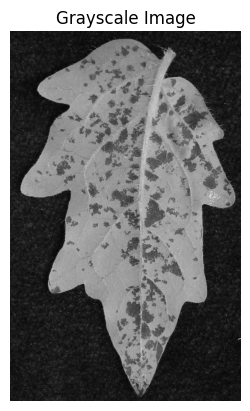

Preprocessing complete for one set of images.
Preprocessing original image:


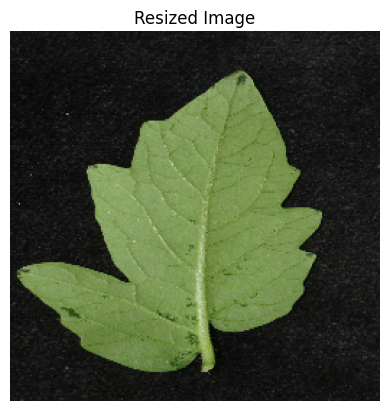

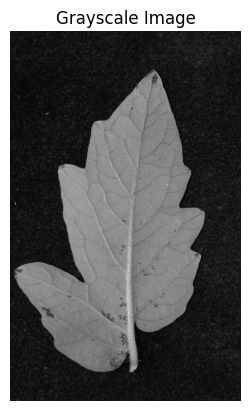

Preprocessing flipped image:


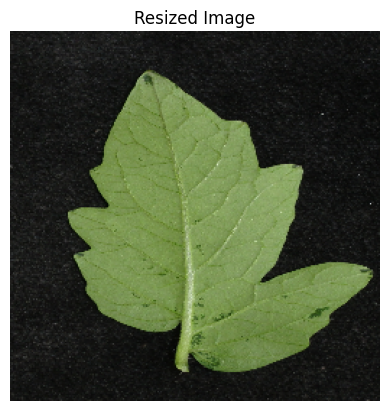

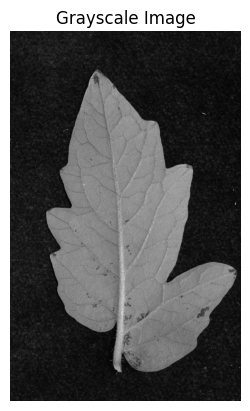

Preprocessing rotated image:


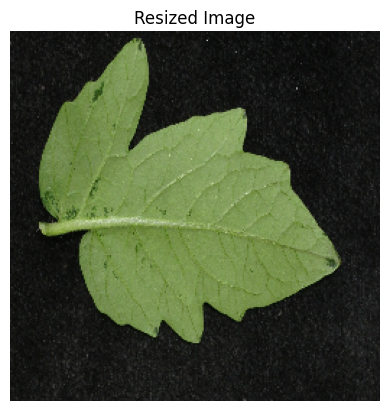

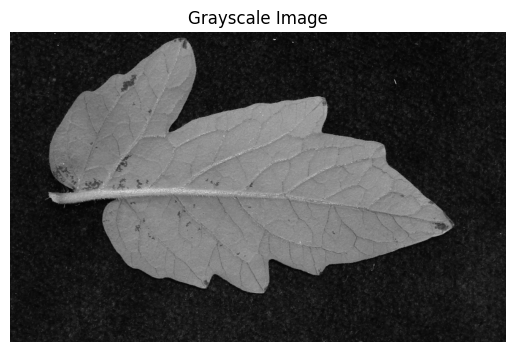

Preprocessing flipped 180 image:


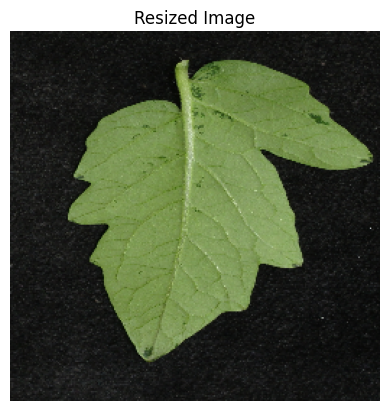

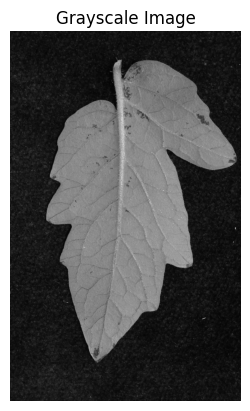

Preprocessing complete for one set of images.
Preprocessing original image:


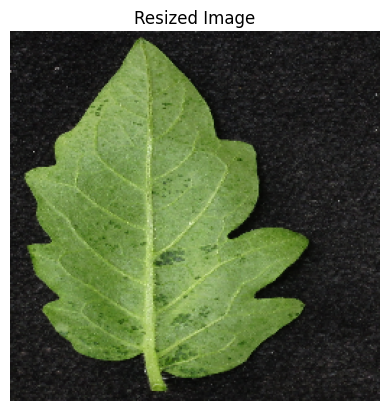

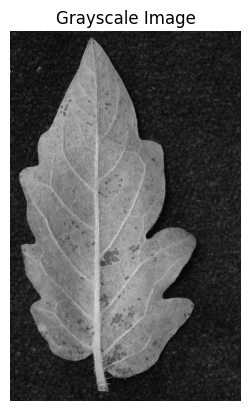

Preprocessing flipped image:


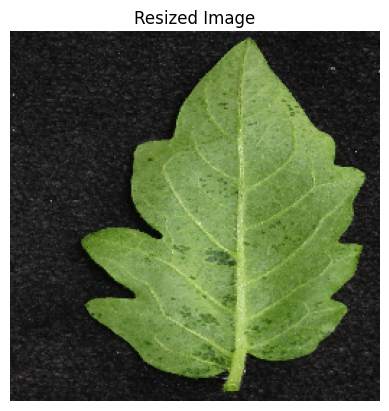

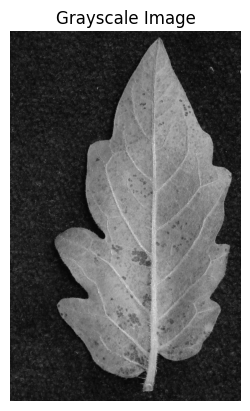

Preprocessing rotated image:


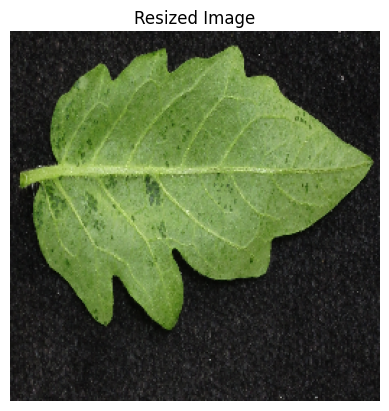

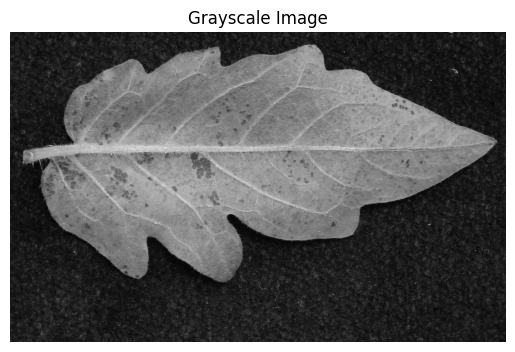

Preprocessing flipped 180 image:


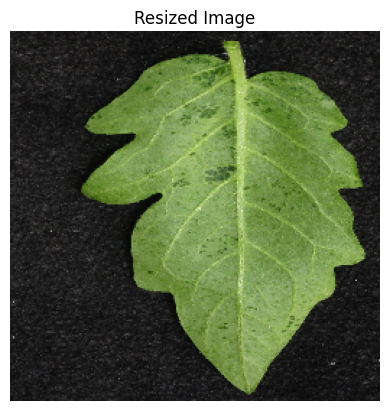

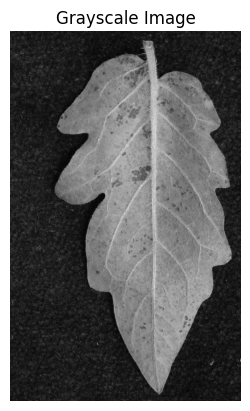

Preprocessing complete for one set of images.
Preprocessing original image:


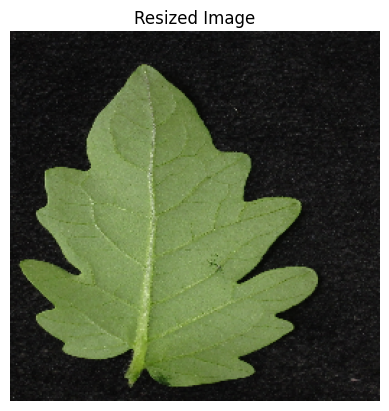

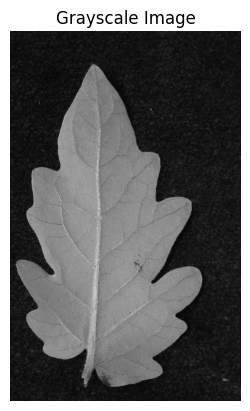

Preprocessing flipped image:


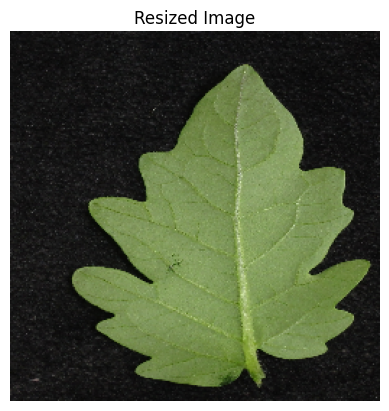

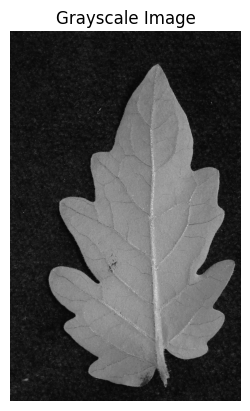

Preprocessing rotated image:


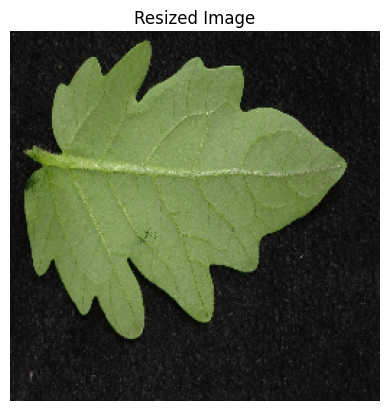

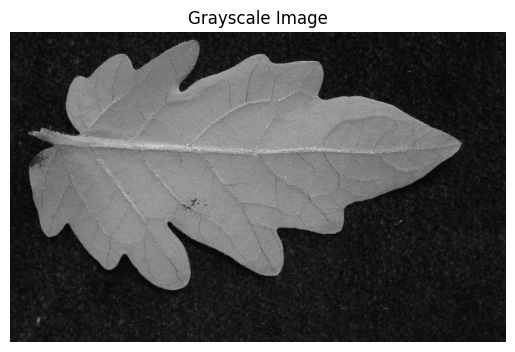

Preprocessing flipped 180 image:


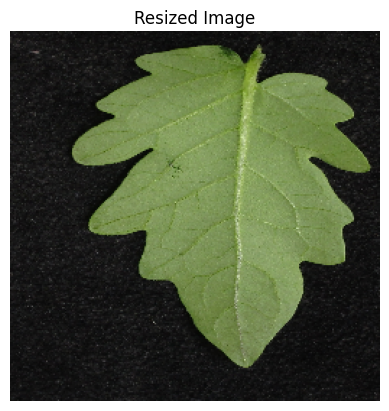

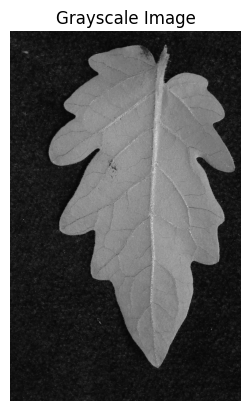

Preprocessing complete for one set of images.
Preprocessing original image:


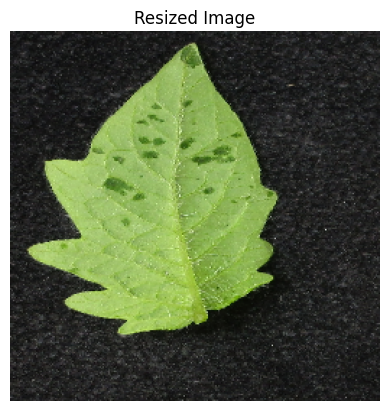

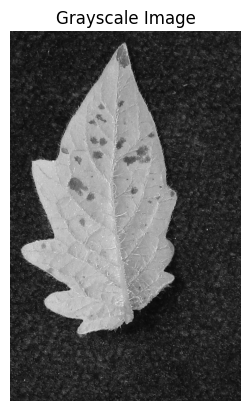

Preprocessing flipped image:


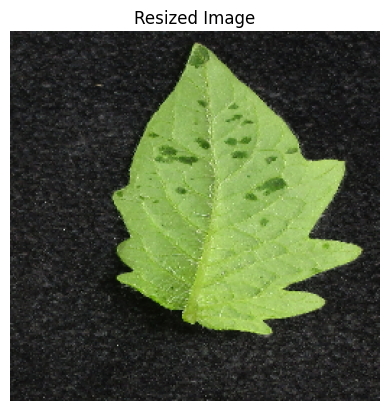

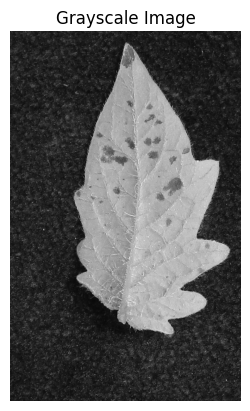

Preprocessing rotated image:


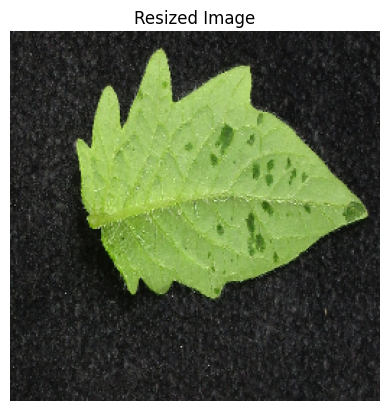

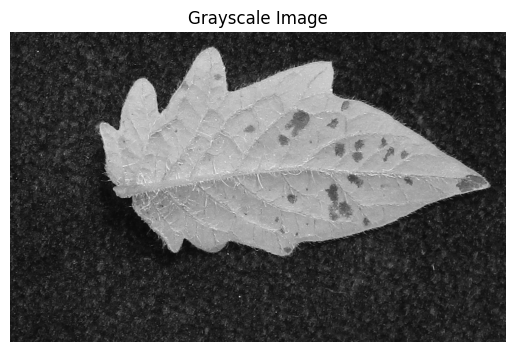

Preprocessing flipped 180 image:


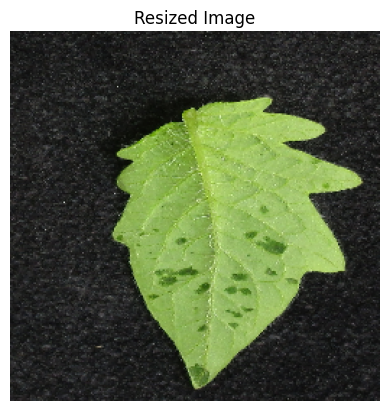

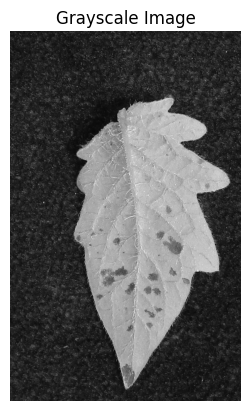

Preprocessing complete for one set of images.
Preprocessing original image:


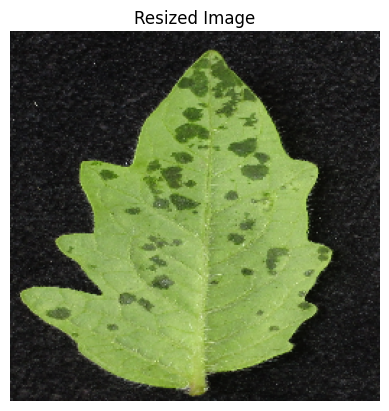

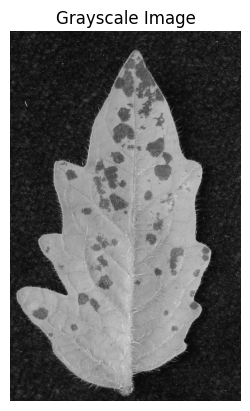

Preprocessing flipped image:


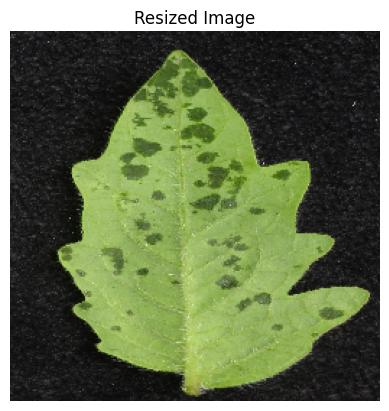

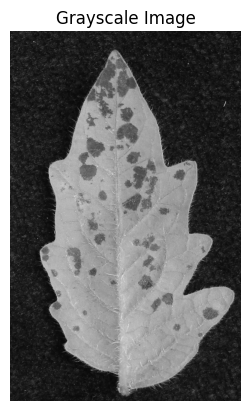

Preprocessing rotated image:


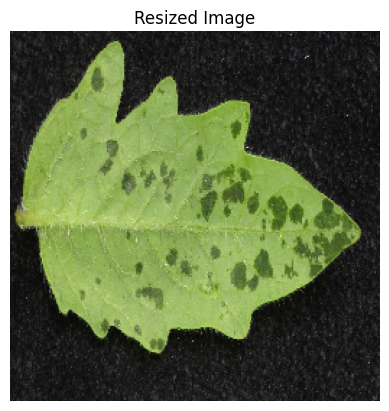

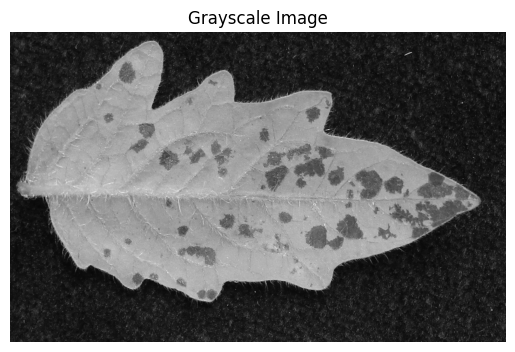

Preprocessing flipped 180 image:


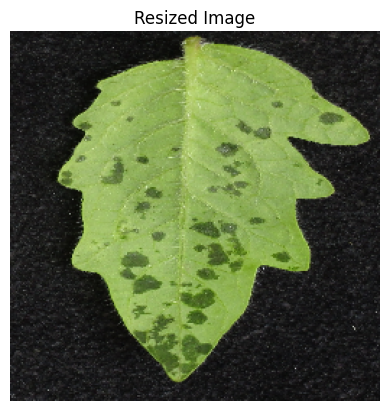

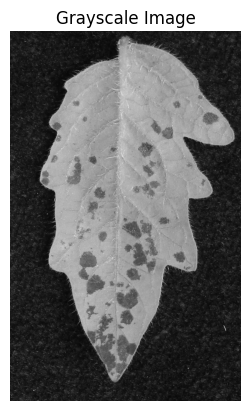

Preprocessing complete for one set of images.


In [25]:
for entry in trainset:
    print("Preprocessing original image:")
    entry['original'] = preprocess_image(entry['original'], resize=True, to_grayscale=True)
    
    print("Preprocessing flipped image:")
    entry['flipped'] = preprocess_image(entry['flipped'], resize=True, to_grayscale=True)
    
    print("Preprocessing rotated image:")
    entry['rotated'] = preprocess_image(entry['rotated'], resize=True, to_grayscale=True)
    
    print("Preprocessing flipped 180 image:")
    entry['flipped_180'] =  preprocess_image(entry['flipped_180'], resize=True, to_grayscale=True)
    
    print("Preprocessing complete for one set of images.")